In [2]:
import cpa
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import torch

sc.set_figure_params(dpi=300, frameon=False)
sc.logging.print_header()

%load_ext autoreload
%autoreload 2

scanpy==1.8.2 anndata==0.7.8 umap==0.5.2 numpy==1.21.5 scipy==1.7.3 pandas==1.3.5 scikit-learn==1.0.2 statsmodels==0.13.1 python-igraph==0.9.9 louvain==0.7.1 pynndescent==0.5.6


In [3]:
adata = sc.read('../datasets/kang.h5ad')

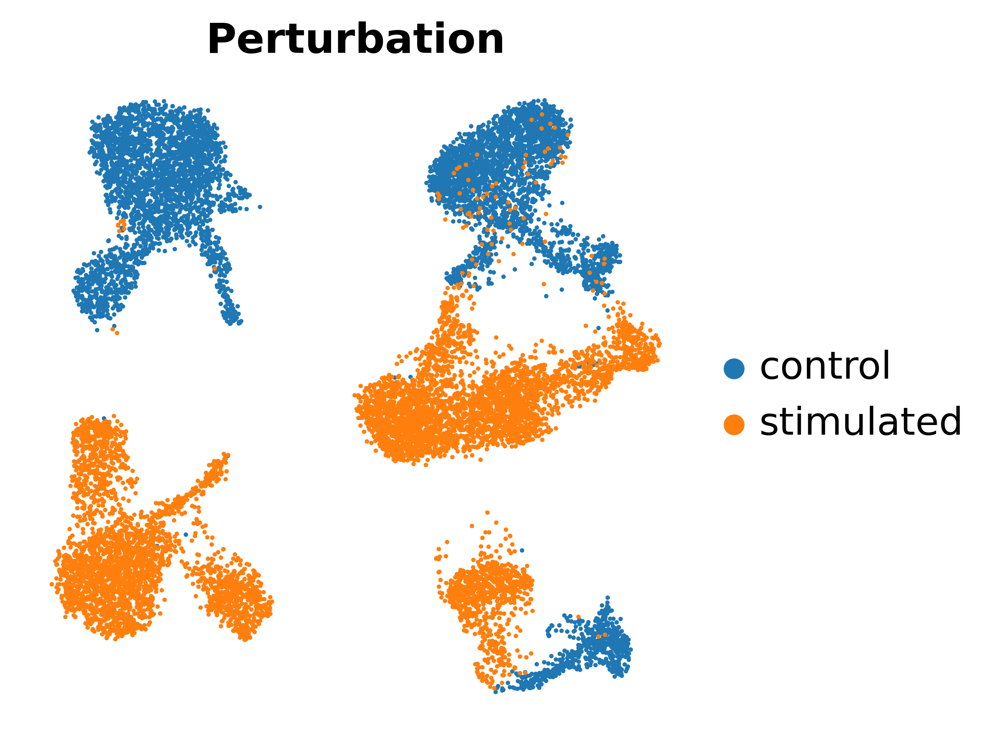

In [4]:
fig, ax = plt.subplots(1, 1)
sc.pl.umap(adata, color='condition', show=False, ax=ax)
ax.set_title('Perturbation', fontweight='bold')
fig.savefig('figures/suppfig_basal/umap.png', dpi=600, bbox_inches='tight')

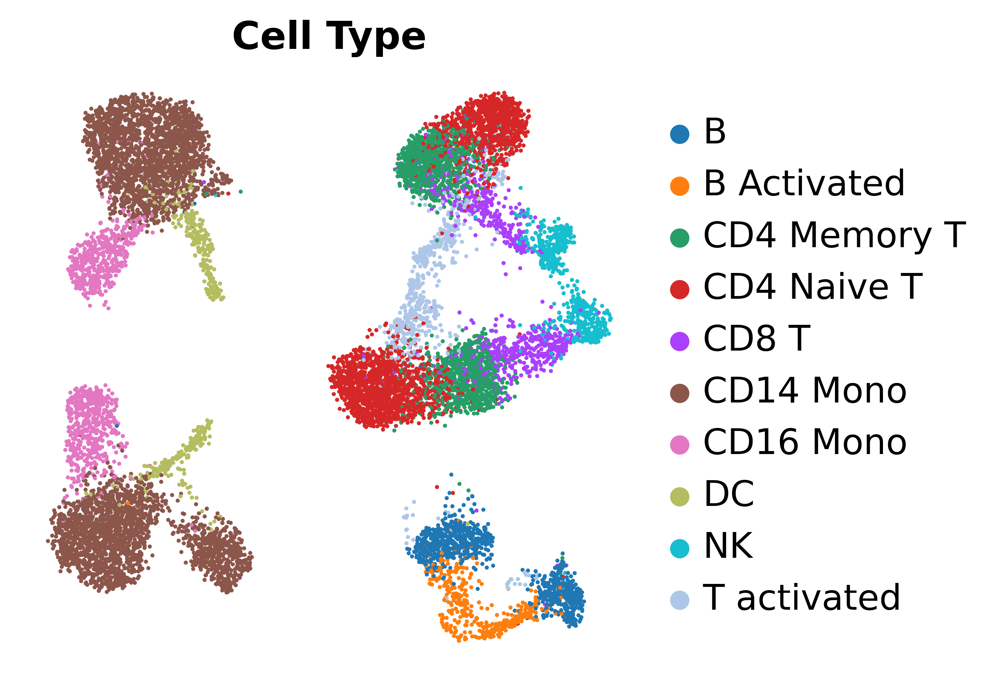

In [5]:
fig, ax = plt.subplots(1, 1)
sc.pl.umap(adata, color='cell_type', show=False, ax=ax)
ax.set_title('Cell Type', fontweight='bold')
fig.savefig('figures/suppfig_basal/umap_Ct.png', dpi=600, bbox_inches='tight')

In [6]:
test_idx = np.random.choice(np.arange(len(adata)), size=int(0.1*len(adata)))
adata.obs['split'] = adata.obs['split'].astype(str)
adata.obs['split'].iloc[test_idx] = 'test'

In [4]:
cpa_api = cpa.api.API(
    adata,
    perturbation_key='condition',
    covariate_keys=['cell_type'],
    dose_key='dose_val',
    decoder_activation='ReLU',
    control='control',
    split_key='split',
    doser_type='linear',
    loss_ae='gauss',
    patience=200,
    hparams={
        'autoencoder_depth': 1,
        'autoencoder_width': 128,
    },
    save_dir='../pretrained_models/r2c1/',
)
cpa_api.train(
    filename='r2c1_1.pt',
    run_eval=True,
    checkpoint_freq=100,
    max_minutes=60,
    max_epochs=1000,
)

Results will be saved to the folder: ../pretrained_models/r2c1/


Rec: -2.2610, AdvPert: 0.68, AdvCov: 1.88: 100%|▉| 999/1000 [09:10<00:00,  1.81i

Model saved to: ../pretrained_models/r2c1/r2c1_1.pt
{'ellapsed_minutes': 8.927406593163807,
 'epoch': 999,
 'evaluation_stats': {'cell_type disentanglement': 0.09876543283462524,
                      'ood': [-1, -1, -1, -1],
                      'optimal for cell_type': 0.1,
                      'optimal for perturbations': 0.5,
                      'perturbation disentanglement': 0.5524691343307495,
                      'test': [0.948924160744984,
                               0.9720676870698626,
                               0.7123704209482781,
                               -0.1207112892306429],
                      'training': [0.9711124775872753,
                                   0.9756730149722468,
                                   0.7129508366473079,
                                   -0.6658698033152065]},
 'training_stats': defaultdict(<class 'float'>,
                               {'loss_adv_covariates': 1.8803310915827751,
                                'loss_adv

Model saved to: ../pretrained_models/r2c1/r2c1_1.pt


In [7]:
cpa_api = cpa.api.API(
    adata,
    pretrained='../pretrained_models/r2c1/r2c1_1.pt'
)

Loaded pretrained model from:	../pretrained_models/r2c1/r2c1_1.pt


Computation time: 9 min


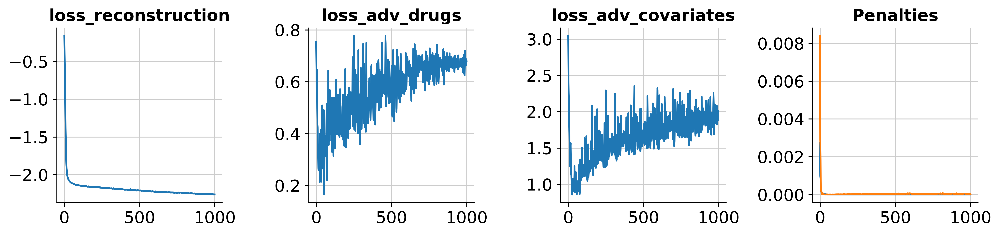

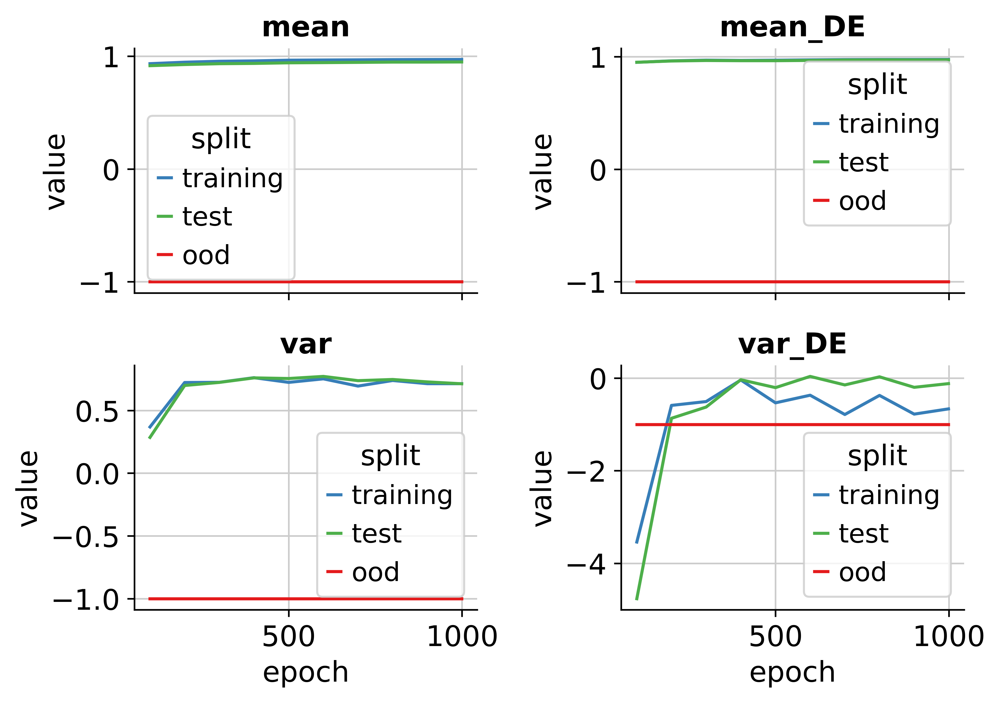

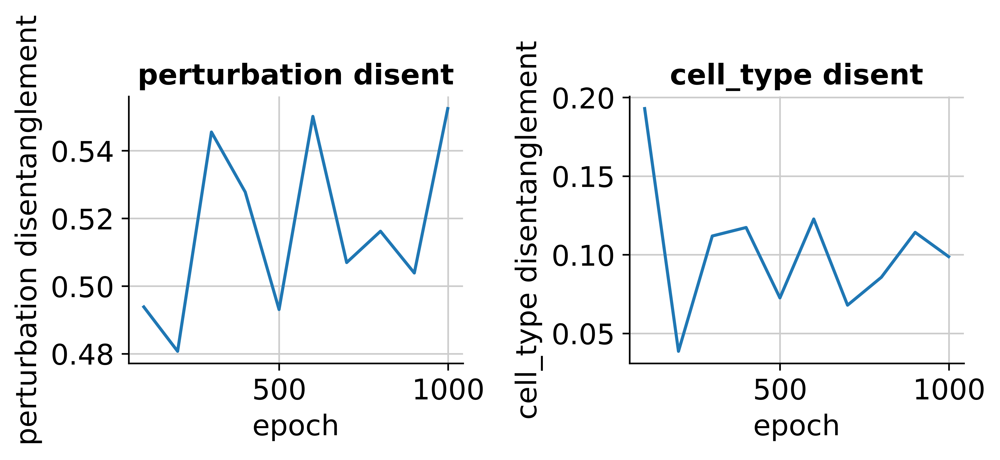

In [8]:
from cpa.plotting import CPAHistory
pretty_history = CPAHistory(cpa_api)
pretty_history.print_time()
pretty_history.plot_losses()
pretty_history.plot_r2_metrics(epoch_min=0)
pretty_history.plot_disentanglement_metrics(epoch_min=0)

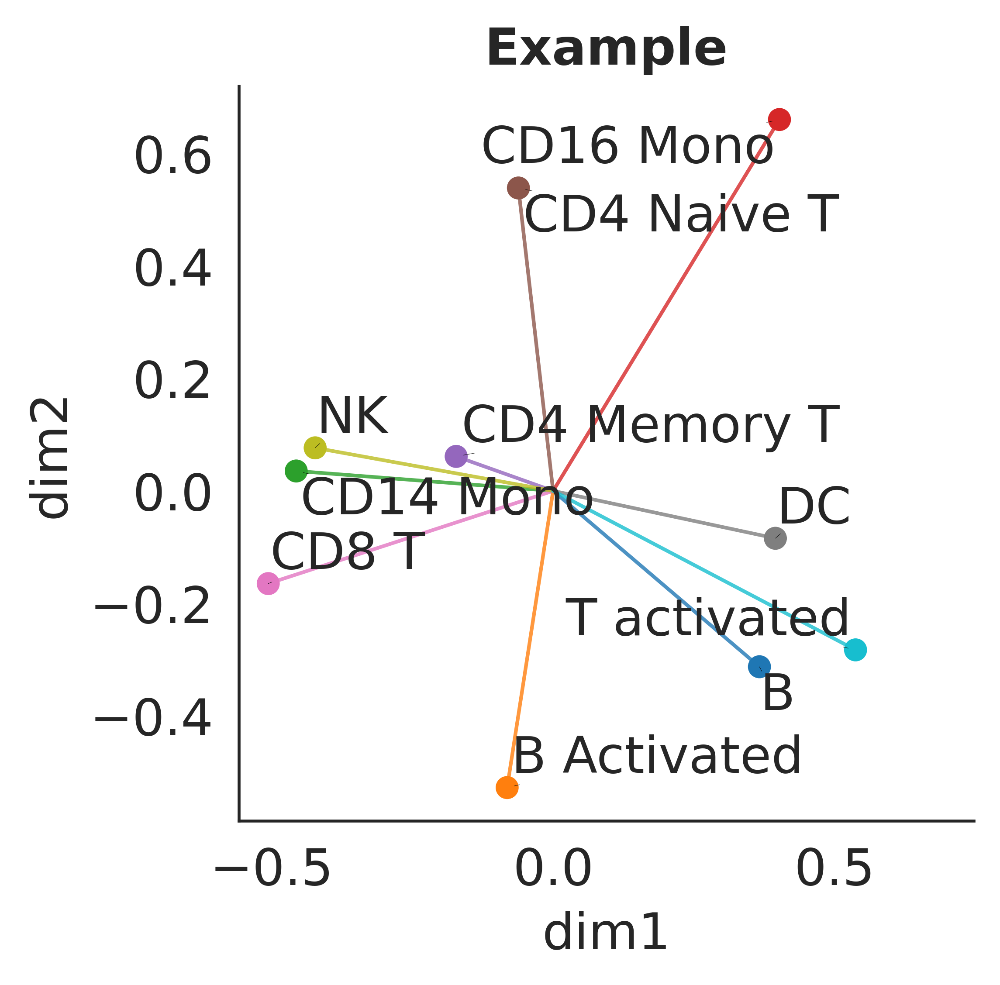

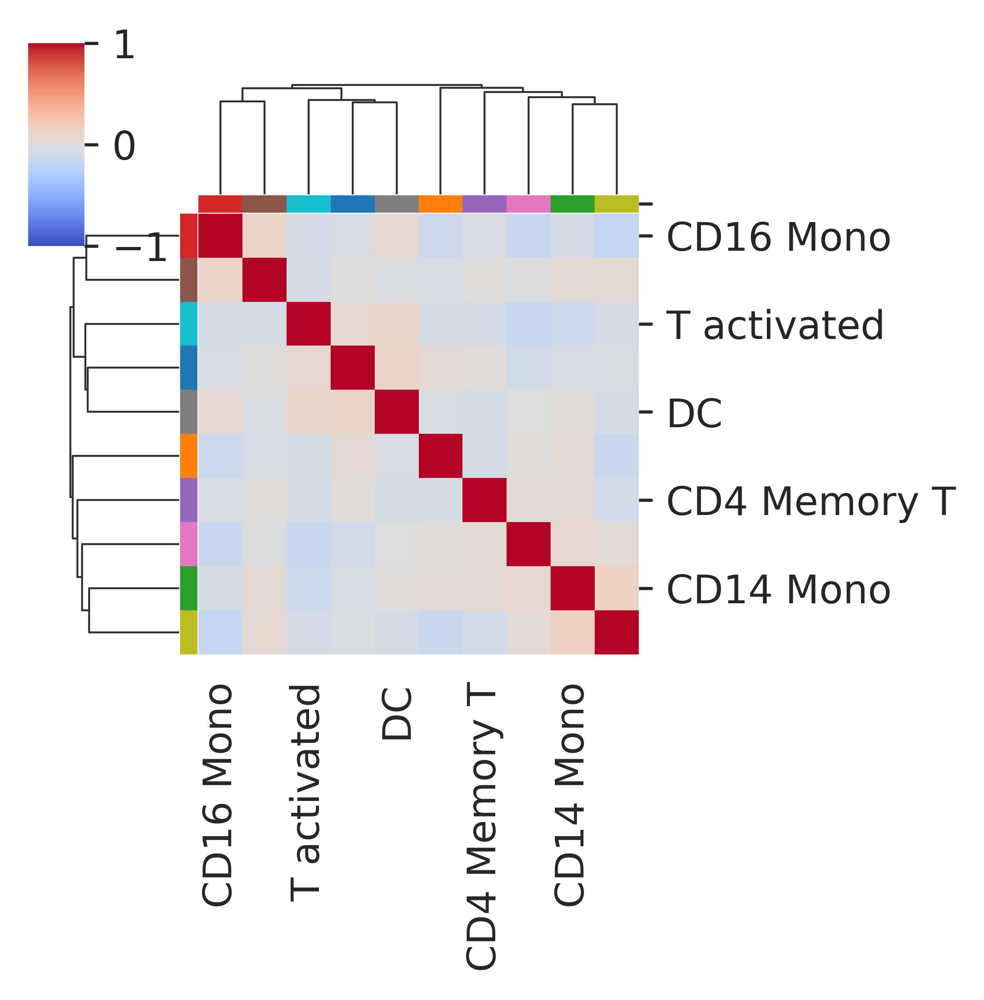

In [9]:
covars_anndata = cpa_api.get_covars_embeddings('cell_type')
cpa_plots = cpa.plotting.CPAVisuals(cpa_api, fileprefix=None)
cpa_plots.plot_latent_embeddings(list(cpa_api.emb_covars['cell_type'].values()), kind='cell_type', show_text=True)

In [10]:
latent = cpa_api.model.encoder(
    torch.tensor(adata.X, device='cuda')
).detach().cpu().numpy()

In [11]:
adata_latent = sc.AnnData(
    X=latent,
    obs=adata.obs
)

In [12]:
sc.pp.pca(adata_latent)
sc.pp.neighbors(adata_latent)
sc.tl.umap(adata_latent)


... storing 'split' as categorical


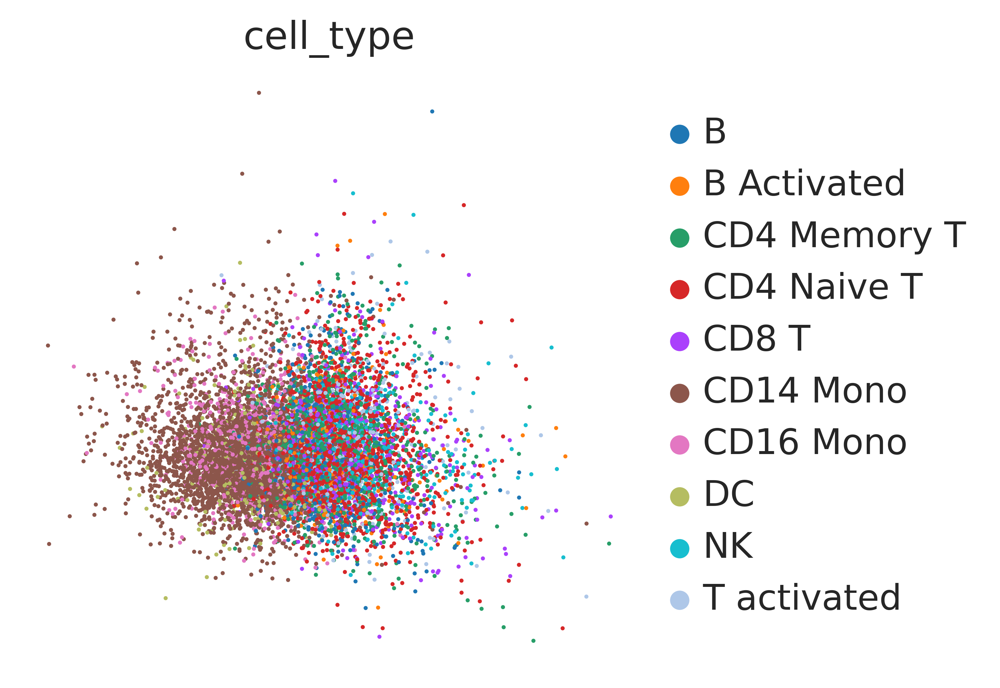

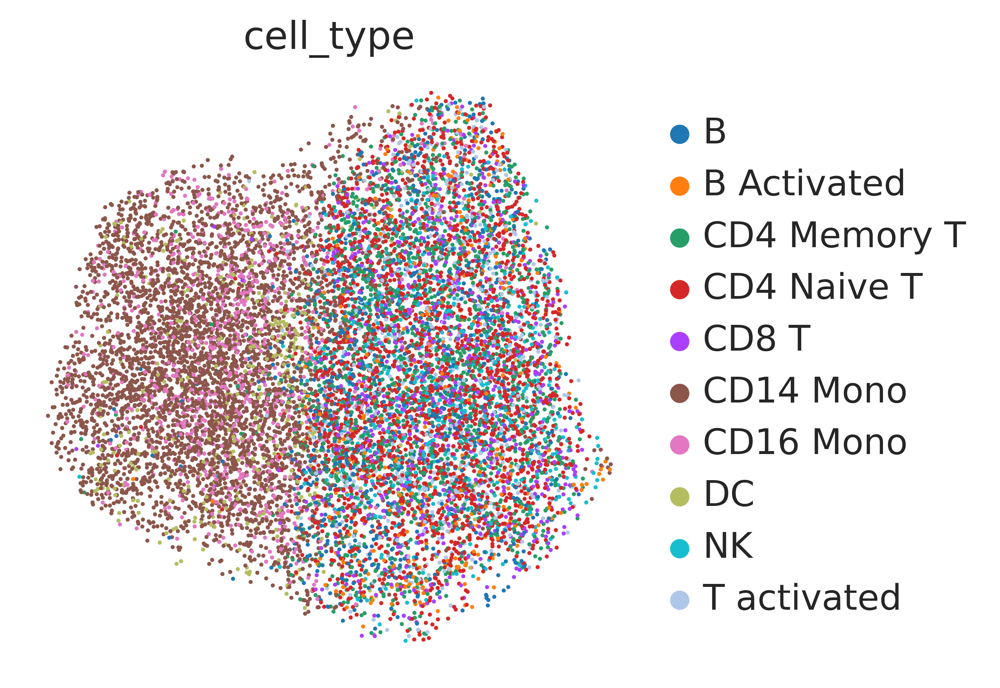

In [13]:
sc.pl.pca(adata_latent, color='cell_type')
sc.pl.umap(adata_latent, color='cell_type')

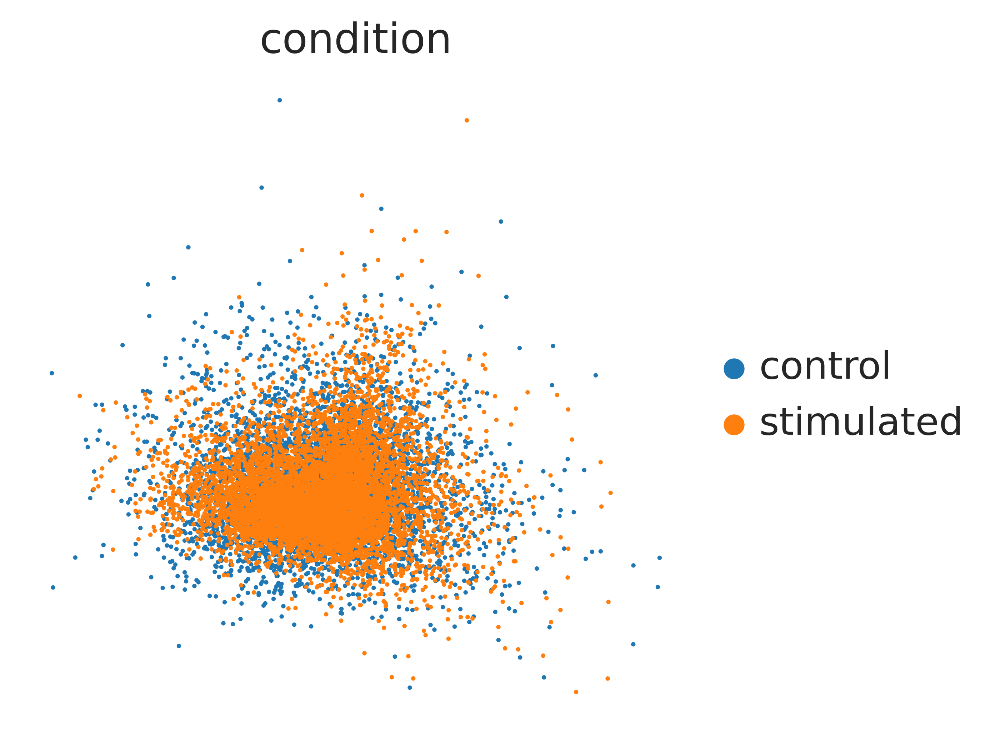

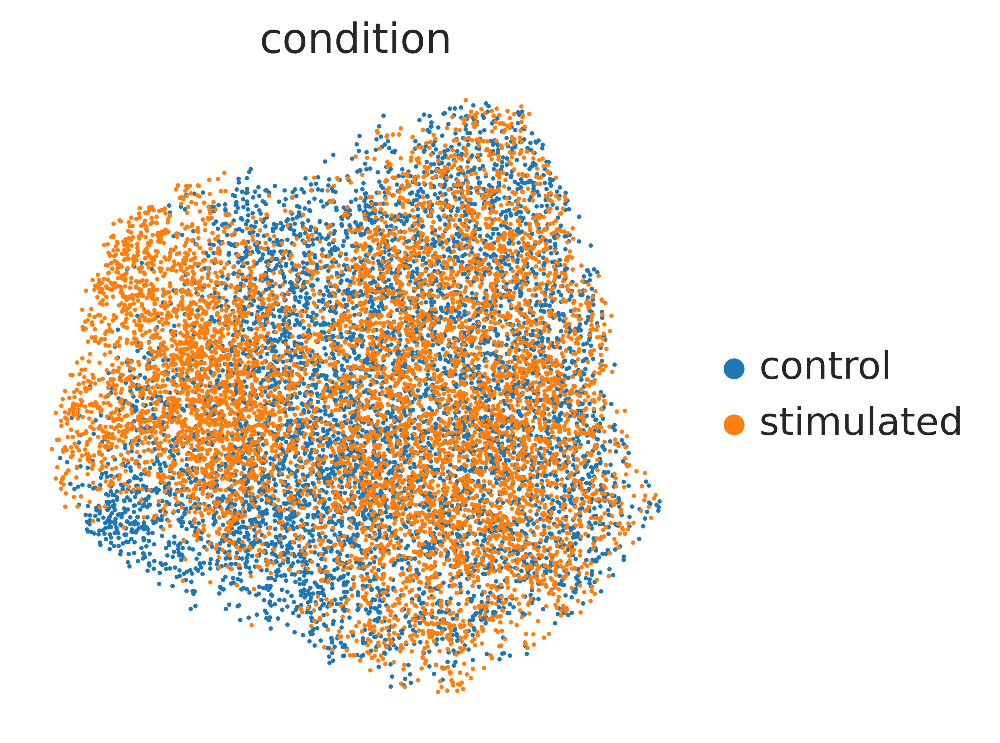

In [14]:
sc.pl.pca(adata_latent, color='condition')
sc.pl.umap(adata_latent, color='condition')

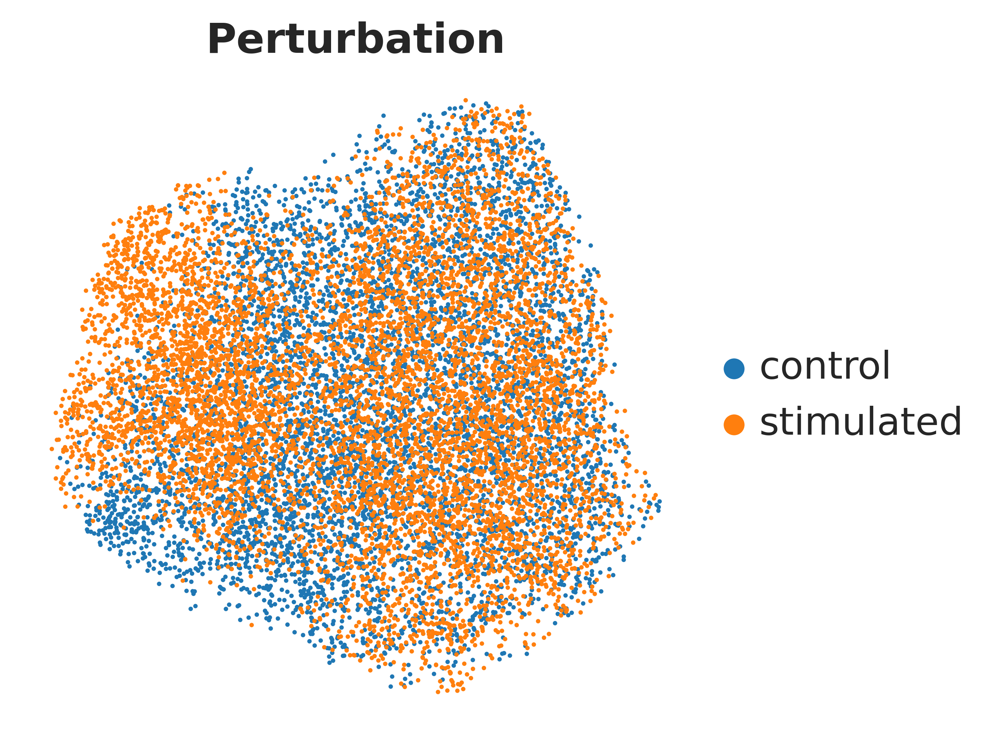

In [15]:
fig, ax = plt.subplots(1, 1)
sc.pl.umap(adata_latent, color='condition', show=False, ax=ax)
ax.set_title('Perturbation', fontweight='bold')
fig.savefig('figures/suppfig_basal/umap_latent.png', dpi=600, bbox_inches='tight')

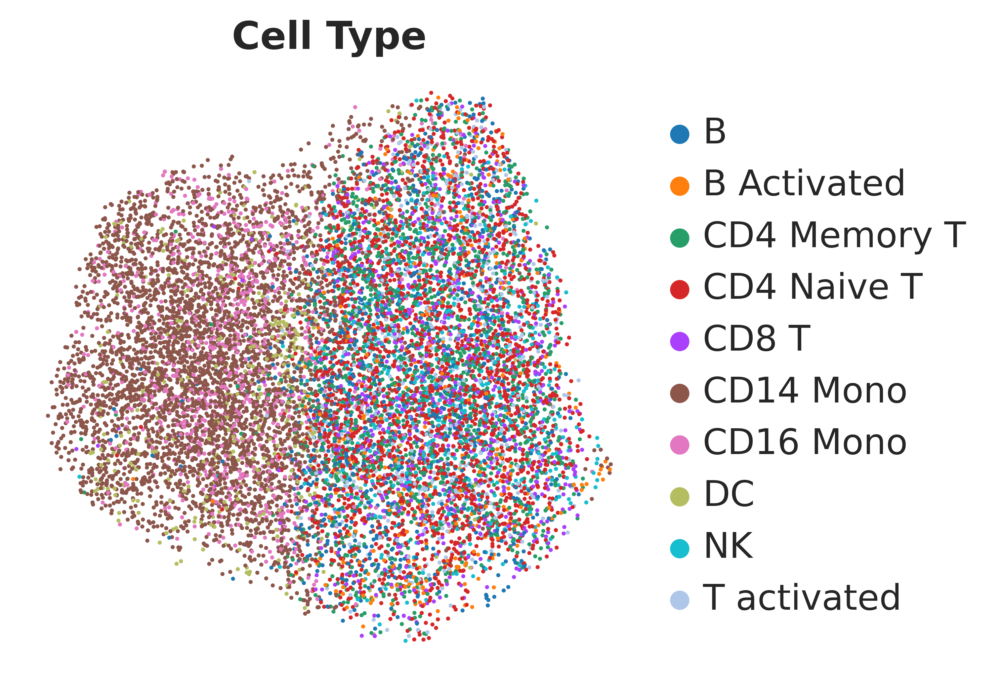

In [16]:
fig, ax = plt.subplots(1, 1)
sc.pl.umap(adata_latent, color='cell_type', show=False, ax=ax)
ax.set_title('Cell Type', fontweight='bold')
fig.savefig('figures/suppfig_basal/umap_latent_ct.png', dpi=600, bbox_inches='tight')

In [12]:
cpa_api_noct = cpa.api.API(
    adata,
    perturbation_key='condition',
    covariate_keys=[],
    dose_key='dose_val',
    doser_type='linear',
    decoder_activation='ReLU',
    control='control',
    split_key='split',
    loss_ae='gauss',
    patience=200,
    hparams={
        'autoencoder_depth': 1,
        'autoencoder_width': 128,
    },  
    save_dir='../pretrained_models/r2c1/'
)
cpa_api_noct.train(
    filename='r2c1_2.pt',
    run_eval=True,
    checkpoint_freq=100,
    max_minutes=60,
    max_epochs=1000,
)

Adding a dummy covariate...
WARNING. Special characters ('_') were found in: 'dummy_cov'. They will be replaced with '-'. Be careful, it may lead to errors downstream.
Creating 'cov_drug_dose_name' field.
Ranking genes for DE genes.


Trying to set attribute `.obs` of view, copying.
... storing 'split' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cov_drug_dose_name' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'covars_comb' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'dummy_cov' as categorical


Results will be saved to the folder: ../pretrained_models/r2c1/


Rec: -2.2267, AdvPert: 0.67, AdvCov: 0.00: 100%|▉| 999/1000 [09:06<00:00,  1.83i

Model saved to: ../pretrained_models/r2c1/r2c1_2.pt
{'ellapsed_minutes': 8.944438926378886,
 'epoch': 999,
 'evaluation_stats': {'dummy_cov disentanglement': 0.0,
                      'ood': [-1, -1, -1, -1],
                      'optimal for dummy_cov': 1.0,
                      'optimal for perturbations': 0.5,
                      'perturbation disentanglement': 0.4652777910232544,
                      'test': [0.9871381037238186,
                               0.9960772266081857,
                               0.5111127216171492,
                               0.2552345853789306],
                      'training': [0.9893200887137372,
                                   0.9967194877701536,
                                   0.5102835061597961,
                                   0.2346860440020705]},
 'training_stats': defaultdict(<class 'float'>,
                               {'loss_adv_covariates': 0.0,
                                'loss_adv_drugs': 0.6749943929413954,
   

Model saved to: ../pretrained_models/r2c1/r2c1_2.pt


In [17]:
cpa_api_noct = cpa.api.API(
    adata,
    pretrained='../pretrained_models/r2c1/r2c1_2.pt',
    covariate_keys=[]
)

Loaded pretrained model from:	../pretrained_models/r2c1/r2c1_2.pt
Adding a dummy covariate...
WARNING. Special characters ('_') were found in: 'dummy_cov'. They will be replaced with '-'. Be careful, it may lead to errors downstream.
Creating 'cov_drug_dose_name' field.
Ranking genes for DE genes.


Trying to set attribute `.obs` of view, copying.
... storing 'split' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cov_drug_dose_name' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'covars_comb' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'dummy_cov' as categorical


Computation time: 9 min


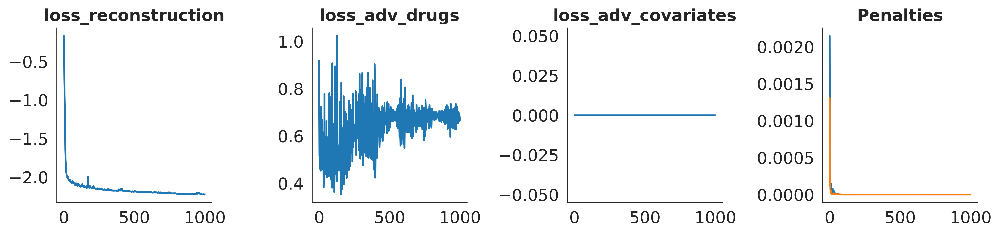

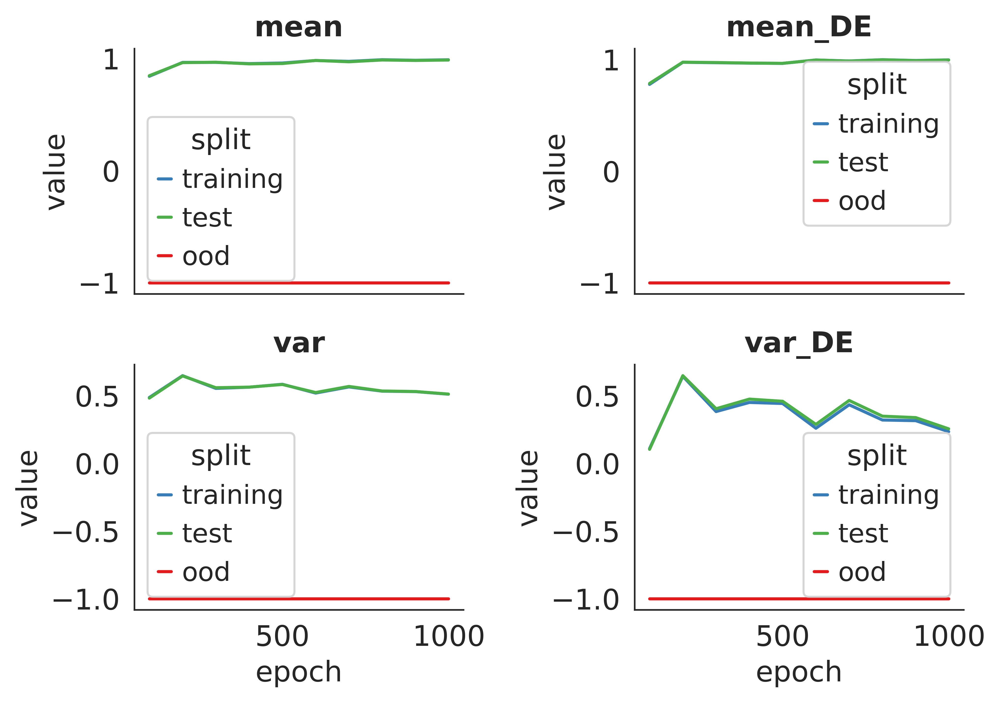

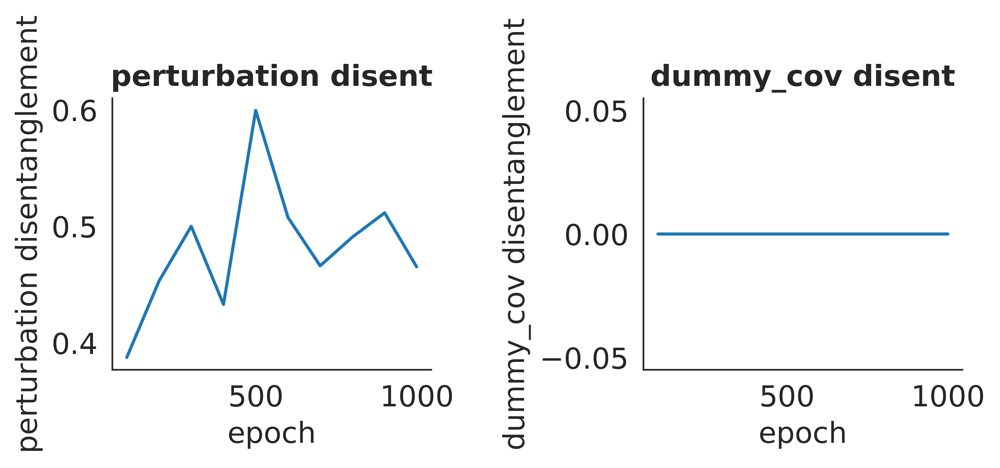

In [18]:
from cpa.plotting import CPAHistory
pretty_history = CPAHistory(cpa_api_noct)
pretty_history.print_time()
pretty_history.plot_losses()
pretty_history.plot_r2_metrics(epoch_min=0)
pretty_history.plot_disentanglement_metrics(epoch_min=0)

In [19]:
latent = cpa_api_noct.model.encoder(
    torch.tensor(adata.X, device='cuda')
).detach().cpu().numpy()

In [20]:
adata_latent = sc.AnnData(
    X=latent,
    obs=adata.obs
)

In [21]:
sc.pp.pca(adata_latent)
sc.pp.neighbors(adata_latent)
sc.tl.umap(adata_latent)


... storing 'split' as categorical
... storing 'cov_drug_dose_name' as categorical
... storing 'covars_comb' as categorical
... storing 'dummy_cov' as categorical


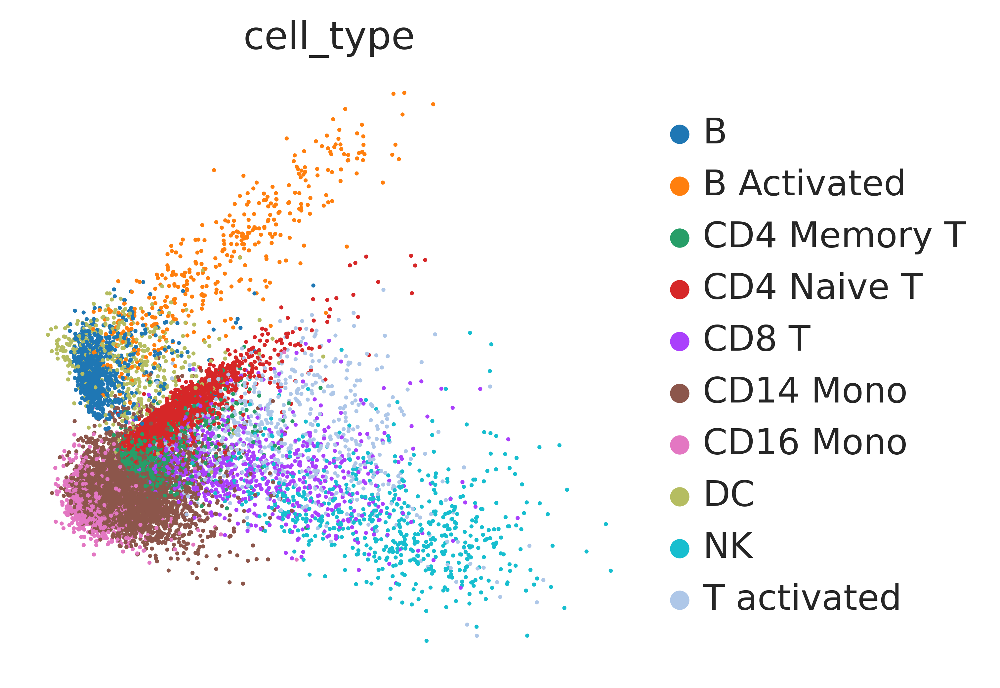

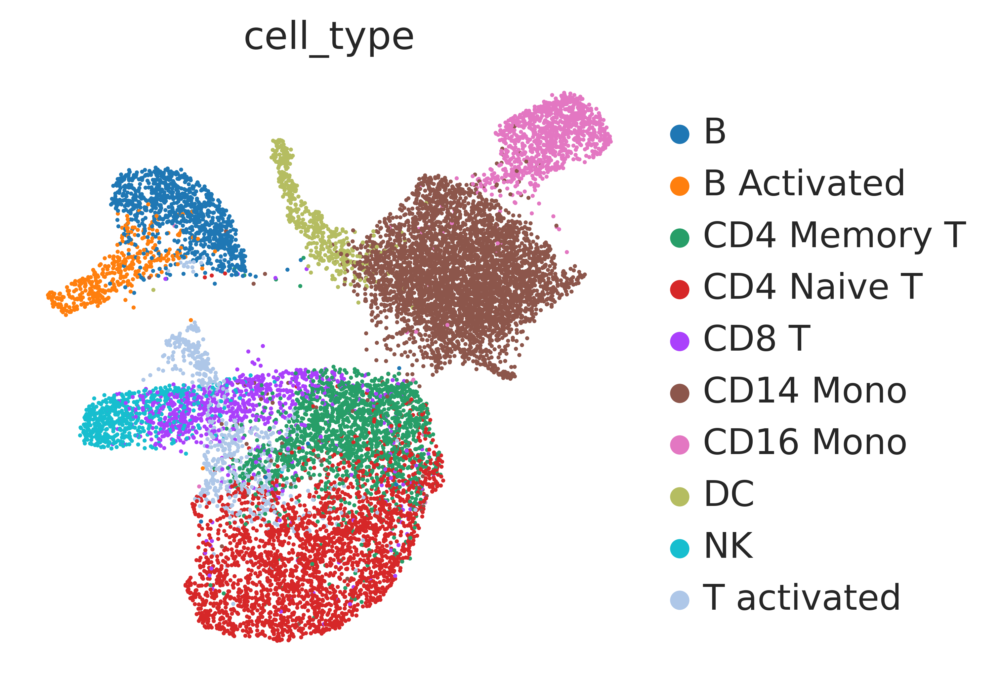

In [22]:
sc.pl.pca(adata_latent, color='cell_type')
sc.pl.umap(adata_latent, color='cell_type')

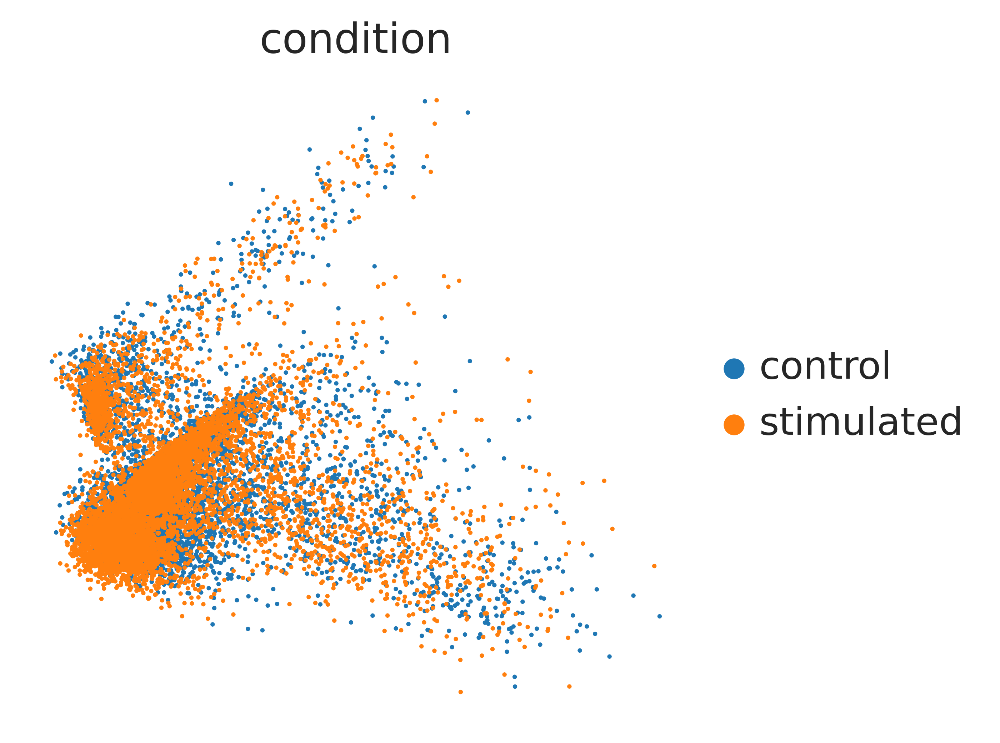

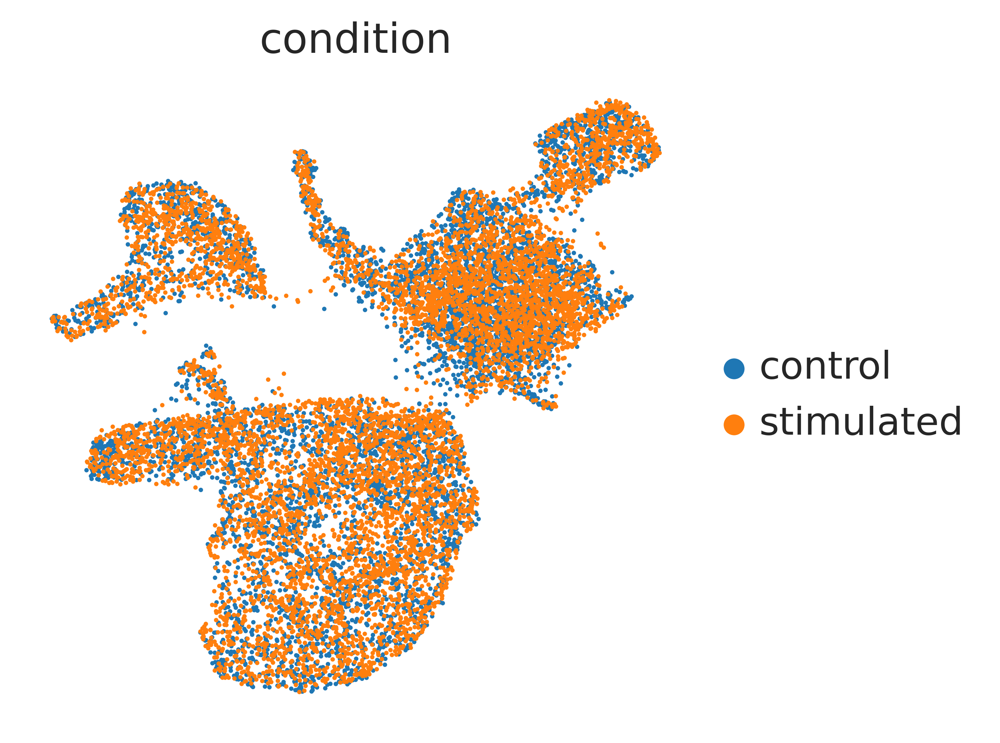

In [23]:
sc.pl.pca(adata_latent, color='condition')
sc.pl.umap(adata_latent, color='condition')

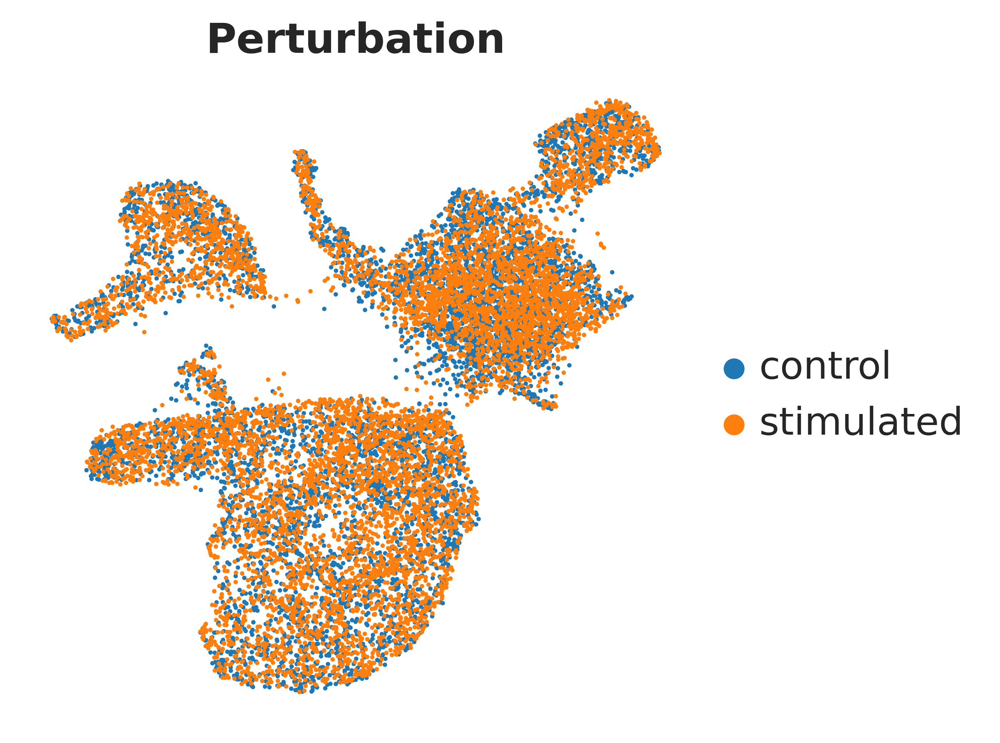

In [24]:
fig, ax = plt.subplots(1, 1)
sc.pl.umap(adata_latent, color='condition', show=False, ax=ax)
ax.set_title('Perturbation', fontweight='bold')
fig.savefig('figures/suppfig_basal/umap_latent_noct.png', dpi=600, bbox_inches='tight')

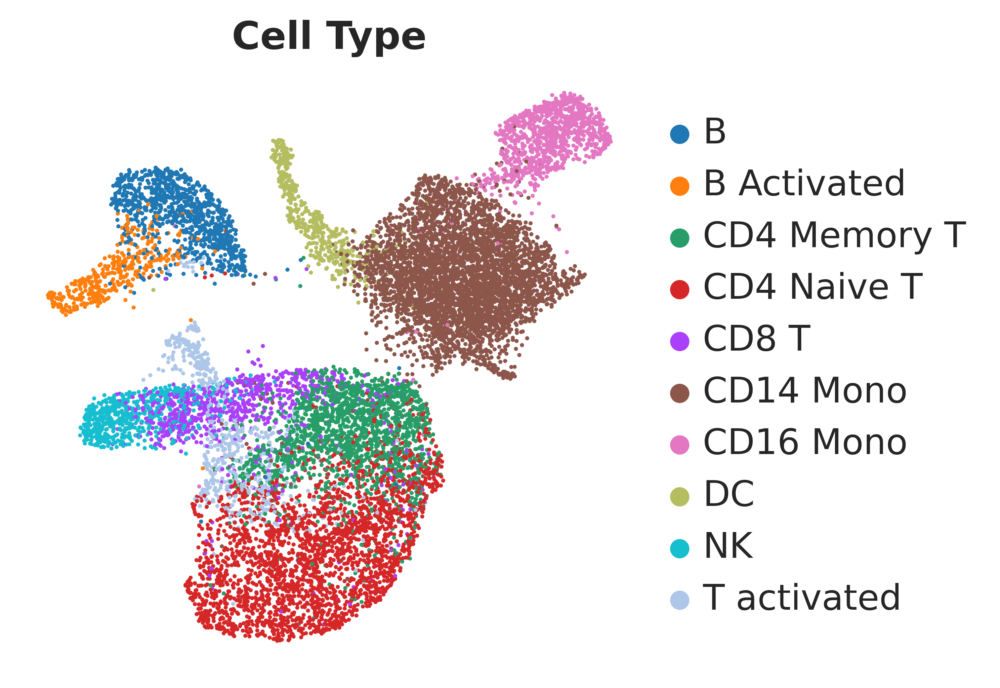

In [25]:
fig, ax = plt.subplots(1, 1)
sc.pl.umap(adata_latent, color='cell_type', show=False, ax=ax)
ax.set_title('Cell Type', fontweight='bold')
fig.savefig('figures/suppfig_basal/umap_latent_noct_ct.png', dpi=600, bbox_inches='tight')

In [26]:
adata_ctrl = adata[adata.obs['condition']=='control']
sc.tl.rank_genes_groups(adata_ctrl, groupby='cell_type')

Trying to set attribute `.obs` of view, copying.
... storing 'split' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cov_drug_dose_name' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'covars_comb' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'dummy_cov' as categorical


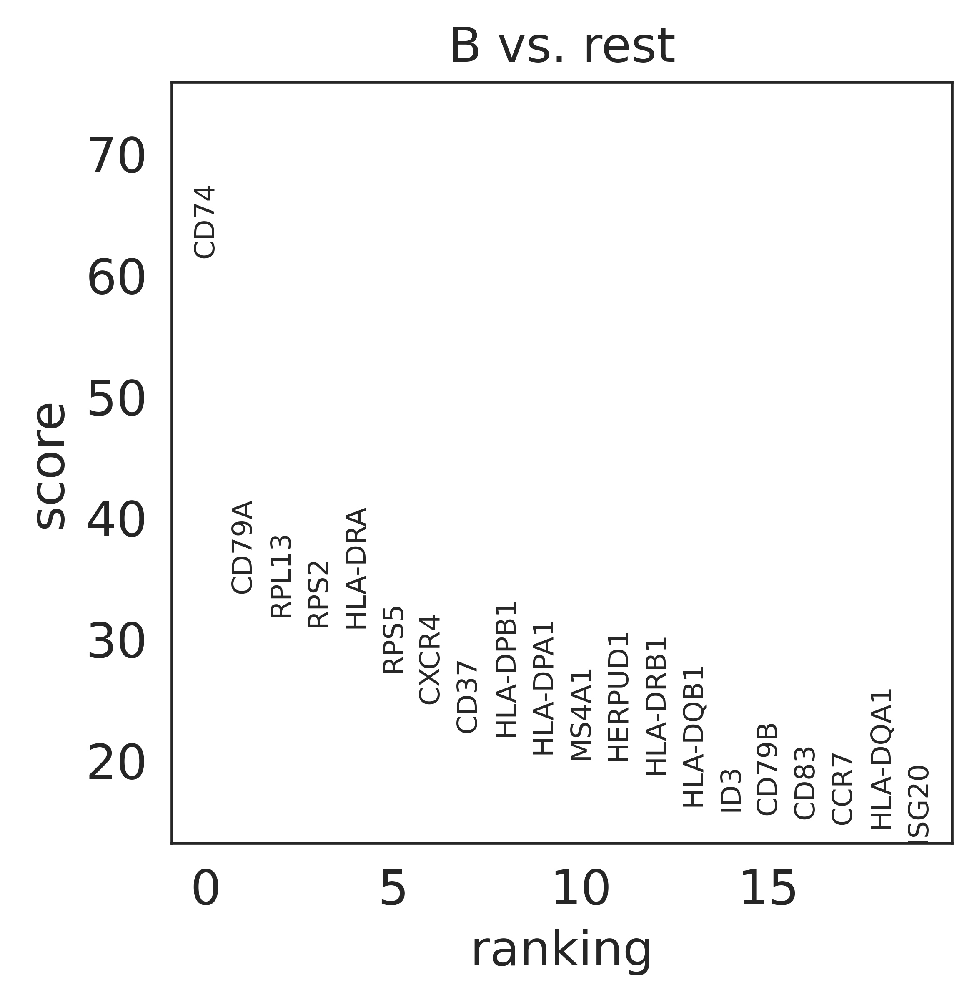

In [77]:
sc.pl.rank_genes_groups(adata_ctrl, groups=['B'])

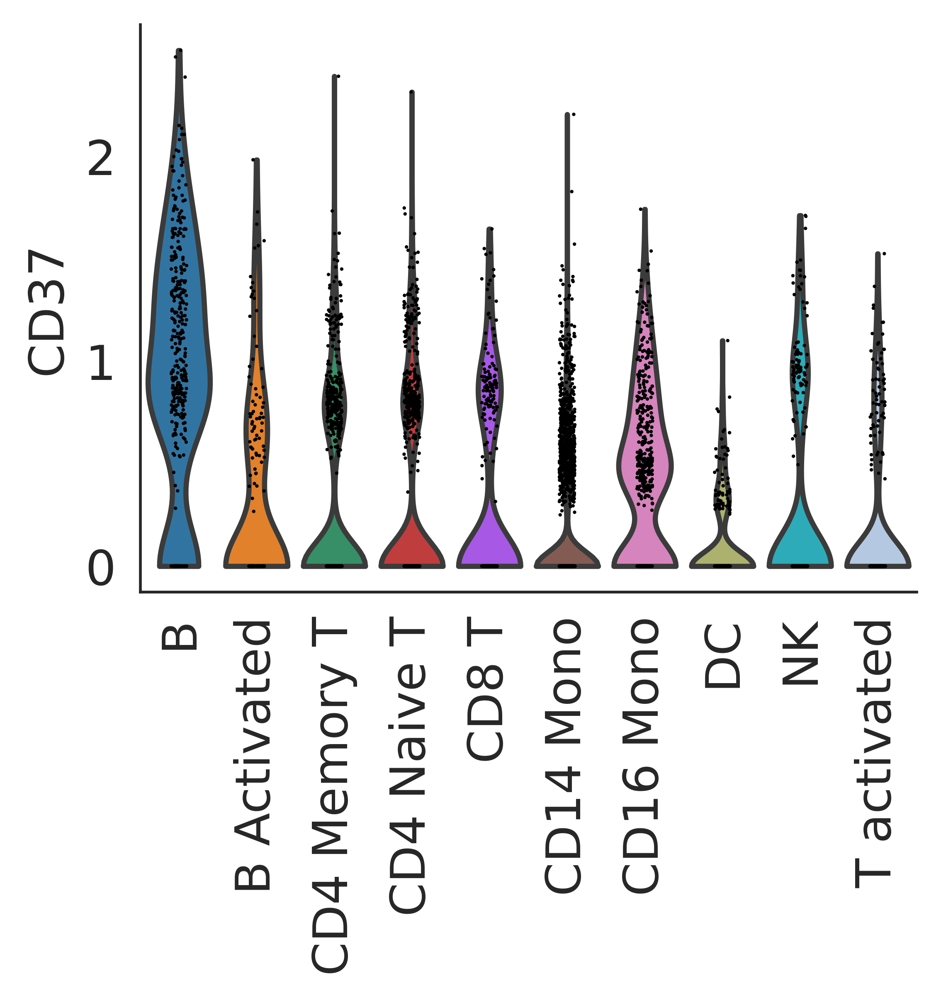

In [109]:
fig, ax = plt.subplots(1, 1, figsize=(4, 3))
sc.pl.violin(adata_ctrl, groupby='cell_type', keys='CD37', rotation=90, ax=ax, show=False)
ax.grid(False)
sns.despine()
fig.savefig('figures/suppfig_basal/B_marker_1.png', dpi=600, bbox_inches='tight')

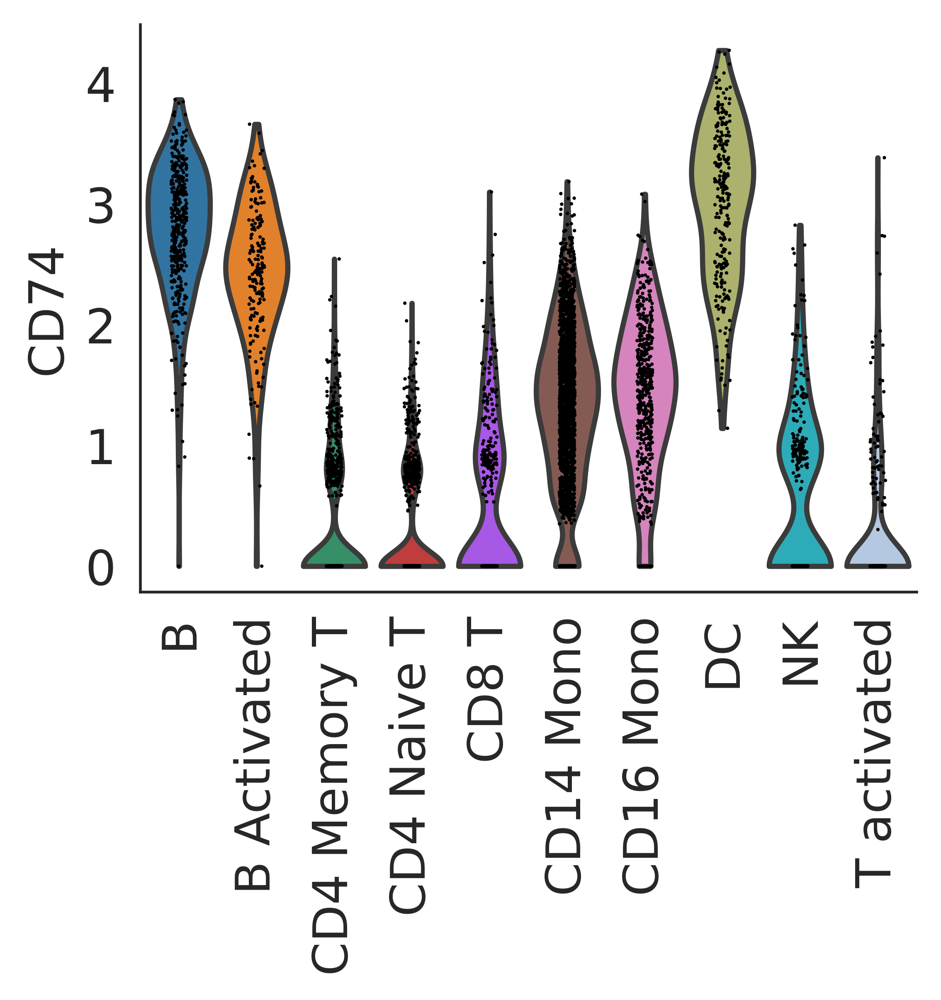

In [87]:
fig, ax = plt.subplots(1, 1, figsize=(4, 3))
sc.pl.violin(adata_ctrl, groupby='cell_type', keys='CD74', rotation=90, ax=ax, show=False)
ax.grid(False)
sns.despine()
fig.savefig('figures/suppfig_basal/B_marker_2.png', dpi=600, bbox_inches='tight')

In [80]:
cpa_api.get_drug_embeddings()
cpa_api.get_covars_embeddings(covars_tgt='cell_type')
cpa_api_noct.get_drug_embeddings()
#cpa_api_noct.get_covars_embeddings(covars_tgt='cell_type')

AnnData object with n_obs × n_vars = 2 × 128
    obs: 'condition'

In [104]:
cpa_api.model.eval()
cpa_api_noct.model.eval()

latent_b = cpa_api.model.encoder(
    torch.tensor(adata[
        (adata.obs['cell_type']=='B') 
        #& (adata.obs['condition'] == 'control')
    ].X, device='cuda')
)
#latent_b = (
    #latent_b 
    #+ torch.tensor(cpa_api.emb_perts[-1], device='cuda')
    #+ torch.tensor(cpa_api.emb_covars['cell_type']['B'], device='cuda')
#)
decoded_basal = cpa_api.model.decoder.forward(latent_b)
decoded_basal= Normal(
    decoded_basal[:, :5000], 
    F.softplus(decoded_basal[:, 5000:]).add(1e-3)
).sample()
decoded_basal[decoded_basal < 0] = 0
decoded_basal = sc.AnnData(
    X=decoded_basal.cpu().detach().numpy(),
    var=adata.var,
)

latent_b_noct = cpa_api_noct.model.encoder(
    torch.tensor(adata[
        (adata.obs['cell_type']=='B') 
        & (adata.obs['condition'] == 'control')
    ].X, device='cuda')
)
latent_b_noct = (
    latent_b_noct 
    #+ torch.tensor(cpa_api_noct.emb_perts[-1], device='cuda')
)
decoded_basal_noct = cpa_api_noct.model.decoder.forward(latent_b_noct)
decoded_basal_noct = Normal(
    decoded_basal_noct[:, :5000], 
    F.softplus(decoded_basal_noct[:, 5000:]).add(1e-3)
).sample()
decoded_basal_noct[decoded_basal_noct < 0] = 0
decoded_basal_noct = sc.AnnData(
    X=decoded_basal_noct.cpu().detach().numpy(),
    var=adata.var,
)

In [105]:
decoded_merged = decoded_basal.concatenate(
    [decoded_basal_noct, adata[(adata.obs['cell_type']=='B') & (adata.obs['condition']=='control')]], 
     batch_key='ct'
)


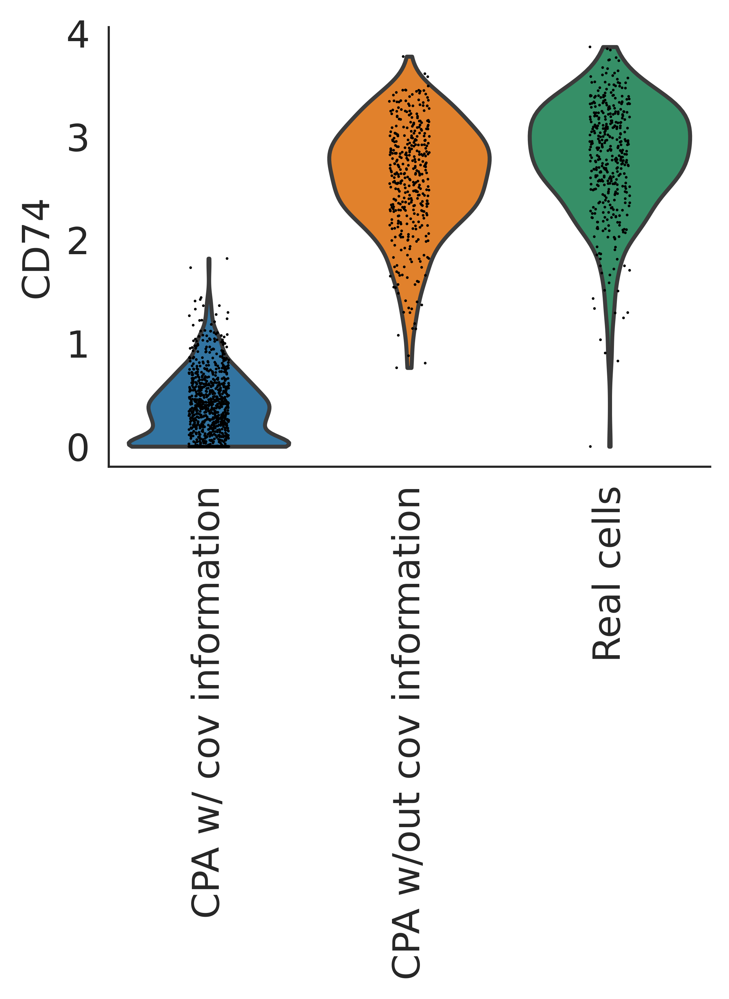

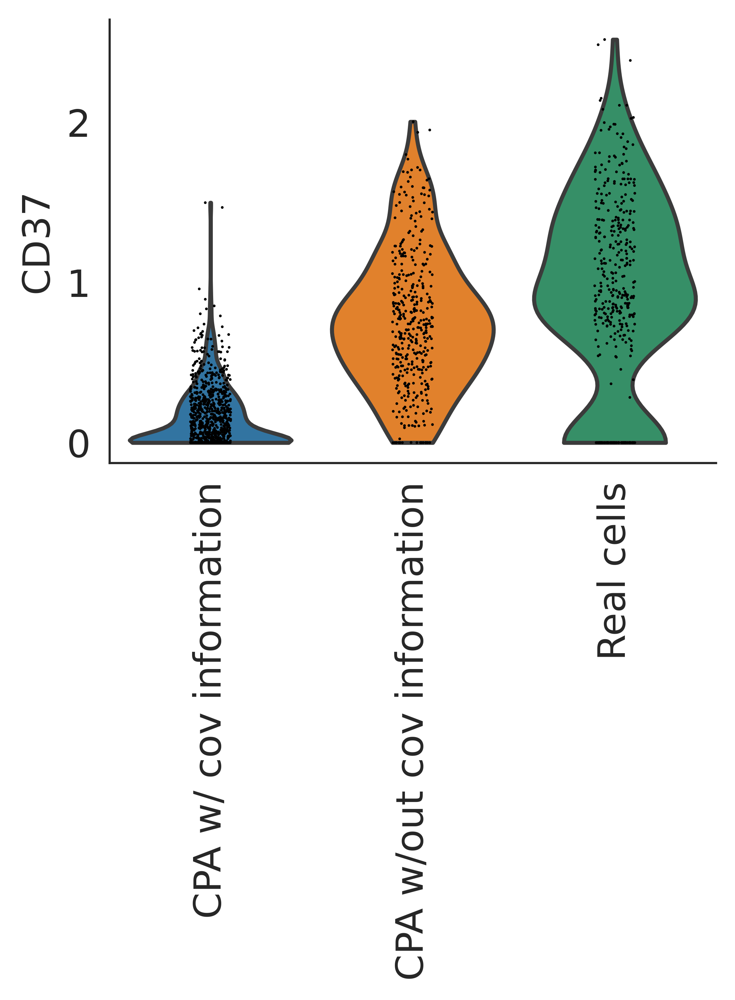

In [108]:
fig, ax = plt.subplots(1, 1, figsize=(4, 3))
sc.pl.violin(decoded_merged, groupby='ct', keys='CD74', show=False, ax=ax)
ax.set_xticklabels(['CPA w/ cov information', 'CPA w/out cov information', 'Real cells'], rotation=90)
ax.set_xlabel('')
sns.despine()
fig.savefig('figures/suppfig_basal/decoded_cd74.png', dpi=600, bbox_inches='tight')

fig, ax = plt.subplots(1, 1, figsize=(4, 3))
sc.pl.violin(decoded_merged, groupby='ct', keys='CD37', show=False, ax=ax)
ax.set_xticklabels(['CPA w/ cov information', 'CPA w/out cov information', 'Real cells'], rotation=90)
ax.set_xlabel('')
sns.despine()
fig.savefig('figures/suppfig_basal/decoded_cd37.png', dpi=600, bbox_inches='tight')

It is possible to see that the second model shows high values of CD74, marker of B cells. Whereas the basal state of the model on the left, has removed that information.